In [143]:
import pandas as pd
import plotly.express as px

## Initial data discovery

Understand data structure, columns type, clean missing values.

In [8]:
df = pd.read_csv("./online_shopping_dataset/file.csv", index_col=0)

In [12]:
df.describe()

,CustomerID,Tenure_Months,Transaction_ID,Quantity,Avg_Price,Delivery_Charges,GST,Offline_Spend,Online_Spend,Month,Discount_pct
count,52924.00000,52924.000000,52924.000000,52924.000000,52924.000000,52924.000000,52924.000000,52924.000000,52924.000000,52955.000000,52555.000000
mean,15346.70981,26.127995,32409.825675,4.497638,52.237646,10.517630,0.137462,2830.914141,1893.109119,6.652800,19.953382
std,1766.55602,13.478285,8648.668977,20.104711,64.006882,19.475613,0.045825,936.154247,807.014092,3.333664,8.127108
min,12346.00000,2.000000,16679.000000,1.000000,0.390000,0.000000,0.050000,500.000000,320.250000,1.000000,10.000000
25%,13869.00000,15.000000,25384.000000,1.000000,5.700000,6.000000,0.100000,2500.000000,1252.630000,4.000000,10.000000
50%,15311.00000,27.000000,32625.500000,1.000000,16.990000,6.000000,0.180000,3000.000000,1837.870000,7.000000,20.000000
75%,16996.25000,37.000000,39126.250000,2.000000,102.130000,6.500000,0.180000,3500.000000,2425.350000,9.000000,30.000000
max,18283.00000,50.000000,48497.000000,900.000000,355.740000,521.360000,0.180000,5000.000000,4556.930000,12.000000,30.000000


In [ ]:
for col in df.columns:
  print(f"{col}: {df[col].dtype}")

Columns:

### Numerical:
- CustomerID
- Tenure_Months
- Transaction_ID
- Quantity
- Avg_Price
- Delivery_Charges
- GST
- Offline_Spend
- Online_Spend
- Discount_pct
- Month

### Categorical - few unique values:
  - Gender
  - Product_Category
  - Coupon_Status
  - Location

### Categorical - many unique values:
  - Product_SKU
  - Product_Description
  - Coupon_Code

### Timeseries:
  - Date
  - Transaction_Date

In [ ]:
df["CustomerID"].isna().sum()
# R: 31 missing entries from CustomerID + other fileds

In [17]:
df.dropna(inplace=True)

In [19]:
df.to_csv("./dataset/OnlineShopping_cleaned.csv")

# EDA plan

Initial thought: Considering multiple types of columns try to render as many plots as possible, taking in count suggestions from: https://www.data-to-viz.com/.

Extra work: consider to associate multiple dimensions under DR (Dimensionality Reduction) - plot 2D and 3D result - understand results.



In [10]:
import pandas as pd
import plotly.express as px

In [11]:
df = pd.read_csv("./dataset/OnlineShopping_cleaned.csv")

In [13]:
# gender distribution
px.histogram(
    data_frame=df,
    x="Gender",
    title="Gender Distribution",
    color="Gender",
    text_auto=True,
    width=800,
)

In [22]:
px.histogram(
    data_frame=df,
    x="Product_Category",
    title="Product Category Distribution",
    color="Product_Category",
    text_auto=True,
    width=900,
    height=600,
)

In [23]:
px.histogram(
    data_frame=df,
    x="Location",
    title="Location Distribution",
    color="Location",
    text_auto=True,
    width=900,
    height=600,
)

In [38]:
px.scatter_3d(
    data_frame=df,
    x="Avg_Price",
    y="Delivery_Charges",
    z="Quantity",
    title="Avg Price vs Delivery Charge Distribution",
    color="Product_Category",
    width=900,
    height=600,
)

In [39]:
px.box(
    data_frame=df,
    x="Product_Category",
    y="Avg_Price",
    title="Avg Price Distribution per Product Category",
    color="Product_Category",
    width=900,
    height=600,
)

In [54]:
px.violin(
    data_frame=df,
    y="Online_Spend",
    title="Online Spend Distribution",
    width=900,
    height=600,
)

In [53]:
px.violin(
    data_frame=df,
    y="Online_Spend",
    x="Product_Category",
    title="Online Spend Distribution per Product Category",
    color="Product_Category",
    width=900,
    height=600,
)

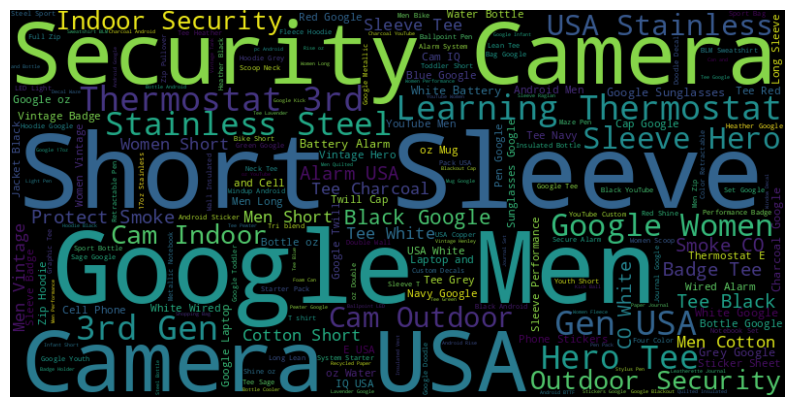

In [18]:
from matplotlib import pyplot as plt

# Word Cloud for Product Description
from wordcloud import WordCloud

text = " ".join(df["Product_Description"].values)
wordcloud = WordCloud(width=800, height=400, stopwords=["Nest"]).generate(text)

plt.figure(figsize=(10, 10))
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()

In [20]:
from matplotlib import pyplot as plt

# Word Cloud for Product Description
from wordcloud import WordCloud

text = " ".join(df["Product_Description"].values)
wordcloud = WordCloud(width=800, height=400, stopwords=["Nest"]).generate(text)
a = wordcloud.process_text(text)
df_ = pd.DataFrame(data=[{"word": key, "count": value} for key, value in a.items()])
df_ = df_.sort_values(by="count", ascending=False)
df_.to_csv("./dataset/Product_Description_WC.csv")

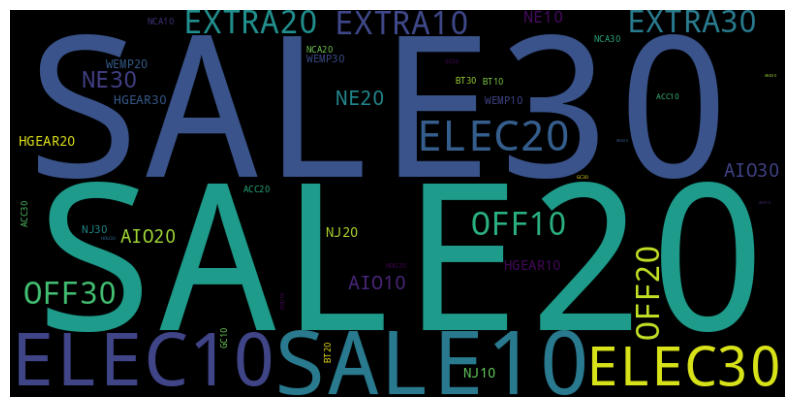

In [24]:
from matplotlib import pyplot as plt

# Word Cloud for Product Description
from wordcloud import WordCloud

wordcloud = WordCloud(
    width=800, height=400, stopwords=["Nest"]
).generate_from_frequencies(df["Coupon_Code"].value_counts().to_dict())

plt.figure(figsize=(10, 10))
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()

In [ ]:
from matplotlib import pyplot as plt

# Word Cloud for Product Description
from wordcloud import WordCloud

text = " ".join(df["Product_Description"].values)
wordcloud = WordCloud(width=800, height=400, stopwords=["Nest"]).generate(text)
a = wordcloud.process_text(text)
df_ = pd.DataFrame(data=[{"word": key, "count": value} for key, value in a.items()])
df_ = df_.sort_values(by="count", ascending=False)
df_.to_csv("./dataset/Product_Description_WC.csv")

In [30]:
px.scatter(
    data_frame=df,
    x="Avg_Price",
    y="Online_Spend",
    size=df["Quantity"],
    color=df["Product_Category"],
    title="Avg Price vs Online Spend",
    width=900,
    height=600,
)

In [48]:
px.parallel_coordinates(
    data_frame=df,
    dimensions=[
        "Avg_Price",
        "Delivery_Charges",
        "Quantity",
        "Online_Spend",
        "Offline_Spend",
        "Discount_pct",
    ],
    title="Parallel Coordinates Plot",
)

In [54]:
px.parallel_categories(
    data_frame=df,
    dimensions=[
      "Gender",
      "Location",
      "Coupon_Status",
      "Product_Category",
    ],
    title="Parallel Categories Plot",
)

In [75]:
px.histogram(
    data_frame=df,
    x="Month",
    color="Gender",
    title="Monthly Spends",
    barmode="group",
    width=900,
    height=600,
)

In [87]:
spends_per_month = df.groupby("Month")[["Online_Spend", "Offline_Spend"]].sum().reset_index()

px.line(
    data_frame=spends_per_month,
    x="Month",
    y=["Online_Spend", "Offline_Spend"],
    title="Monthly Spends",
)

In [91]:
df["Date"] = pd.to_datetime(df["Date"])
spends_per_month = df.groupby("Date")[["Online_Spend", "Offline_Spend"]].sum().reset_index()

px.line(
    data_frame=spends_per_month,
    x="Date",
    y=["Online_Spend", "Offline_Spend"],
    title="Spends Over Time",
)

In [90]:
df["Transaction_Date"] = pd.to_datetime(df["Transaction_Date"])
spends_per_month = df.groupby("Transaction_Date")[["Online_Spend", "Offline_Spend"]].sum().reset_index()

px.line(
    data_frame=spends_per_month,
    x="Transaction_Date",
    y=["Online_Spend", "Offline_Spend"],
    title="Spends Over transaction date",
)

In [109]:
df["Date"] = pd.to_datetime(df["Date"])
spends_per_month = (
    df.groupby(["Date", "Gender"])[["Online_Spend", "Offline_Spend"]]
    .sum()
    .reset_index()
)
spends_per_month["Spends"] = (
    spends_per_month["Online_Spend"] + spends_per_month["Offline_Spend"]
)

px.area(
    data_frame=spends_per_month,
    x="Date",
    y="Spends",
    color="Gender",
    title="Spends Over Time per Gender",
    line_shape="spline",
)

In [184]:
import numpy as np
import plotly.graph_objects as go

df["Date"] = pd.to_datetime(df["Date"])
spends_per_month = (
    df.groupby(["Date", "Gender"])[["Online_Spend", "Offline_Spend"]]
    .sum()
    .reset_index()
)
spends_per_month["Spends"] = (
    spends_per_month["Online_Spend"] + spends_per_month["Offline_Spend"]
)


# fill missing dates for male and female gender with 0
dates = pd.date_range(
    start=spends_per_month["Date"].min(), end=spends_per_month["Date"].max()
)
dates = pd.DataFrame(dates, columns=["Date"])

spends_male = spends_per_month[spends_per_month["Gender"] == "M"].reset_index(drop=True)
spends_male = pd.merge(dates, spends_male, how="left", left_on="Date", right_on="Date")
spends_male.fillna(0, inplace=True)

spends_female = spends_per_month[spends_per_month["Gender"] == "F"].reset_index(
    drop=True
)
spends_female = pd.merge(
    dates, spends_female, how="left", left_on="Date", right_on="Date"
)
spends_female.fillna(0, inplace=True)

spends_female["M>F"] = spends_female["Spends"] < spends_male["Spends"]
# spends_female["M>F"].replace({True: "rgba(250,0,0,0.4)", False: "rgba(0,0,250,0.4)"}, inplace=True)
spends = pd.merge(
    left=spends_male, right=spends_female, how="left", left_on="Date", right_on="Date"
)
spends_ = spends[["Date", "Spends_x", "Spends_y"]]
spends["label"] = np.where(spends["Spends_x"] > spends["Spends_y"], 1, 0)
spends["group"] = spends["label"].ne(spends["label"].shift()).cumsum()
spends = spends.groupby("group")


def fillcol(label):
    if label:
        return "rgba(0,0,250,0.4)"
    else:
        return "rgba(250,0,0,0.4)"


dfs = []
for name, data in spends:
    dfs.append(data)

fig = go.Figure()

for df_ in dfs:
    fig.add_traces(
        go.Scatter(x=df_["Date"], y=df_["Spends_x"], line=dict(color="rgba(0,0,0,0)"))
    )

    fig.add_traces(
        go.Scatter(
            x=df_["Date"],
            y=df_["Spends_y"],
            line=dict(color="rgba(0,0,0,0)"),
            fill="tonexty",
            fillcolor=fillcol(df_["label"].iloc[0]),
        )
    )

fig.add_traces(
    go.Scatter(
        x=spends_["Date"],
        y=spends_["Spends_x"],
        mode="lines",
        name="Total Spends",
        line=dict(color="blue"),
    )
)

fig.add_trace(
    go.Scatter(
        x=spends_["Date"],
        y=spends_["Spends_y"],
        mode="lines",
        name="Total Spends",
        line=dict(color="red"),
    )
)

fig.update_layout(showlegend=False, title="Spends Over Time")
fig.show()

In [4]:
from geopy.geocoders import Nominatim

In [5]:
df["Location-ISO"] = df["Location"].replace(
    {
        "Chicago": "US-IL",
        "California": "US-CA",
        "New York": "US-NY",
        "New Jersey": "US-NJ",
        "Washington DC": "US-DC",
    }
)

df["Location-ISO"].unique()

array(['US-IL', 'US-CA', 'US-NY', 'US-NJ', 'US-DC'], dtype=object)

In [6]:
loc = Nominatim(user_agent="Geopy Library")

# entering the location name
getLoc = loc.geocode("US-IL")


# printing latitude and longitude
print("Latitude = ", getLoc.latitude, "\n")
print("Longitude = ", getLoc.longitude)

Latitude =  40.0796606 

Longitude =  -89.4337288


In [7]:
lat = {}
lon = {}
for location in df["Location-ISO"].unique():
    getLoc = loc.geocode(location)
    lat[location] = getLoc.latitude
    lon[location] = getLoc.longitude

In [8]:
df["Lat"] = df["Location-ISO"].apply(lambda x: lat[x])
df["Long"] = df["Location-ISO"].apply(lambda x: lon[x])

In [9]:
df.to_csv("./dataset/OnlineShopping.csv")

In [24]:
df_country_transactions = df.groupby(["Location-ISO", "Lat", "Long"])["Transaction_ID"].count().reset_index()

In [36]:
# bubble chart on map
from plotly import graph_objects as go

fig = go.Figure()

fig.add_trace(
    go.Scattergeo(
        locationmode="USA-states",
        lon=df_country_transactions["Long"],
        lat=df_country_transactions["Lat"],
        text=df_country_transactions["Location-ISO"],
        marker=dict(
            size=df_country_transactions["Transaction_ID"]/10,
            line_color="rgb(40,40,40)",
            color=df_country_transactions["Transaction_ID"],
            line_width=0.5,
            sizemode="area",
        ),
        name="Transactions",
    )
)

fig.update_layout(
    title_text="Transactions per Location",
    showlegend=True,
    geo=dict(
        scope="usa",
        landcolor="rgb(217, 217, 217)",
    ),
)

fig.show()

In [43]:
# bubble chart on map
from plotly import graph_objects as go

df_country_transactions = df.groupby(["Location-ISO", "Product_Category", "Lat", "Long"])["Transaction_ID"].count().reset_index()

fig = go.Figure()

fig.add_trace(
    go.Scattergeo(
        locationmode="USA-states",
        lon=df_country_transactions["Long"],
        lat=df_country_transactions["Lat"],
        text=df_country_transactions["Product_Category"],
        marker=dict(
            size=df_country_transactions["Transaction_ID"]/5,
            line_color="rgb(40,40,40)",
            color=df_country_transactions["Product_Category"].astype("category").cat.codes,
            line_width=0.5,
            sizemode="area",
        ),
        name="Transactions",
    )
)

fig.update_layout(
    title_text="Transactions per Location per Product Category",
    showlegend=True,
    geo=dict(
        scope="usa",
        landcolor="rgb(217, 217, 217)",
    ),
)

fig.show()

In [54]:
import pandas as pd
import numpy as np
import plotly.graph_objects as go

fig = go.Figure()

df["Date"] = pd.to_datetime(df["Date"])
for category in df["Product_Category"].unique():
    df_category = df[df["Product_Category"] == category]
    df_category = df_category.groupby("Date")["Transaction_ID"].count().reset_index()
    df_category["Transaction_ID"] = np.log(df_category["Transaction_ID"])
    fig.add_trace(
        go.Scatter(
            x=df_category["Date"],
            y=df_category["Transaction_ID"],
            mode="lines",
            name=category,
            stackgroup="one",
        )
    )

fig.update_layout(title="Transactions Over Time per Product Category")


In [69]:
import pandas as pd
import numpy as np
import plotly.graph_objects as go

fig = go.Figure()

df["Date"] = pd.to_datetime(df["Date"])
for category in df["Product_Category"].unique():
    df_category = df[df["Product_Category"] == category]
    df_category = df_category.groupby("Date")["Transaction_ID"].count().reset_index()
    df_category["Transaction_ID"] = df_category["Transaction_ID"]
    fig.add_trace(
        go.Scatter(
            x=df_category["Date"],
            y=df_category["Transaction_ID"],
            mode="lines",
            name=category,
            stackgroup="one",
        )
    )


fig.update_layout(title="Transactions Over Time per Product Category")